#**Imports**

In [1]:
!pip install pyLDAvis
!pip install nltk

     |████████████████████████████████| 1.6MB 5.8MB/s 
  Created wheel for pyLDAvis: filename=pyLDAvis-2.1.2-py2.py3-none-any.whl size=97712 sha256=9ad958547483885975b4711b8e9af33aefad68092689bbabc57933c97e0cf01a
  Stored in directory: /root/.cache/pip/wheels/98/71/24/513a99e58bb6b8465bae4d2d5e9dba8f0bef8179e3051ac414
Successfully built pyLDAvis


In [2]:
#Import libraries
import re
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# spacy for lemmatization
import spacy

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

pd.set_option('display.max_rows', 5000)
pd.set_option('display.max_columns', 5000)
pd.set_option('display.width', 1000)

from IPython.display import display, HTML
display(HTML(data="""
<style>
   div#notebook-container    { width: 95%; }
   div#menubar-container     { width: 95%; }
   div#maintoolbar-container { width: 99%; }
</style>
"""))

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [4]:
import os
PATH = os.getcwd()
DATADIR = PATH + '/drive/My Drive/Long.csv'

In [5]:
#Read data
raw_data = pd.read_csv(DATADIR)
raw_data.shape

(4518, 4)

In [6]:
raw_data.head()

,Index,Source,Text,Length
0,1,Susanli,An unfounded conspiracy theory and pro-Kremlin...,1001
1,2,Susanli,To all my wonderful people in Liberia: While y...,1002
2,3,Susanli,Microsoft has recently patented an invention t...,1003
3,4,Susanli,We are moving towards a totalitarian state of ...,1009
4,5,Susanli,A top U.S. scientist and research pioneer Dr. ...,1018


#**Preprocessing**

In [7]:
# NLTK Stop words
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stop_words = stopwords.words('english')
stop_words.extend(['com', 'response', 'request'])

# Convert to list
data = raw_data.Text.values.tolist()

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [8]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(data))

In [9]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
#print(trigram_mod[bigram_mod[data_words[3]]])

/usr/local/lib/python3.6/dist-packages/gensim/models/phrases.py:598: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")


In [10]:
# Define functions for stopwords, bigrams, trigrams and lemmatization
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

In [11]:
# Remove Stop Words
data_words_nostops = remove_stopwords(data_words)

# Form Bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
nlp = spacy.load('en', disable=['parser', 'ner'])

# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

#print(data_lemmatized[:1])

In [12]:
# Create Dictionary
id2word = corpora.Dictionary(data_lemmatized)

# Create Corpus
texts = data_lemmatized

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
#print(corpus[:1])

In [13]:
# Human readable format of corpus (term-frequency)
[[(id2word[id], freq) for id, freq in cp] for cp in corpus[:5]]

[[('alert', 1),
  ('begin', 1),
  ('believe', 1),
  ('case', 5),
  ('cause', 1),
  ('chinese', 1),
  ('city', 1),
  ('confirm', 4),
  ('day', 1),
  ('disease', 1),
  ('disinformation', 1),
  ('infect', 2),
  ('italian', 1),
  ('later', 1),
  ('man', 1),
  ('market', 1),
  ('new', 1),
  ('number', 1),
  ('ongoe', 1),
  ('originate', 1),
  ('place', 1),
  ('quickly', 1),
  ('repatriate', 1),
  ('report', 1),
  ('rise', 1),
  ('rome', 1),
  ('several', 1),
  ('third', 1),
  ('tourist', 1),
  ('travel', 1),
  ('unfounded', 1),
  ('unknown', 1),
  ('virus', 1),
  ('week', 1),
  ('wholesale', 1),
  ('work', 1)],
 [('atenae', 1),
  ('attention', 1),
  ('babe', 1),
  ('beam', 1),
  ('better', 1),
  ('body', 1),
  ('bring', 1),
  ('business', 1),
  ('community', 1),
  ('company', 1),
  ('damage', 1),
  ('deform', 1),
  ('destroy', 1),
  ('destruction', 1),
  ('disassociate', 1),
  ('engage', 1),
  ('even', 1),
  ('evil', 1),
  ('eye', 1),
  ('fatality', 1),
  ('general', 1),
  ('get', 1),
  ('g

In [14]:
len(corpus)

4518

#**Compute coherence scores for N topics**

In [15]:
%%time
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=num_topics, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values


CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 6.44 µs


In [16]:
%%time
# Can take a long time to run.
model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=data_lemmatized, start=2, limit=20, step=1)

CPU times: user 29min 7s, sys: 42.4 s, total: 29min 49s
Wall time: 29min 5s


In [17]:
import seaborn as sns
plt.style.use("seaborn")

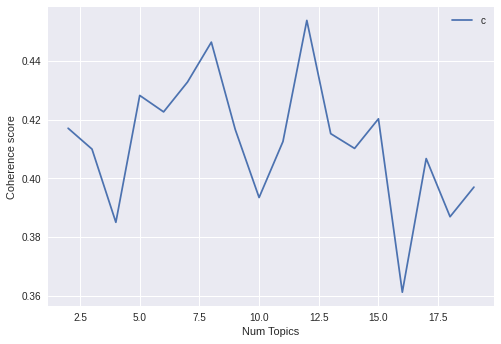

In [18]:
## Plot the coherence scores for different N topics
### Select optimum N

# Show graph
limit=20; start=2; step=1;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [19]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.4171
Num Topics = 3  has Coherence Value of 0.41
Num Topics = 4  has Coherence Value of 0.385
Num Topics = 5  has Coherence Value of 0.4282
Num Topics = 6  has Coherence Value of 0.4226
Num Topics = 7  has Coherence Value of 0.4328
Num Topics = 8  has Coherence Value of 0.4464
Num Topics = 9  has Coherence Value of 0.4167
Num Topics = 10  has Coherence Value of 0.3935
Num Topics = 11  has Coherence Value of 0.4125
Num Topics = 12  has Coherence Value of 0.4538
Num Topics = 13  has Coherence Value of 0.4152
Num Topics = 14  has Coherence Value of 0.4102
Num Topics = 15  has Coherence Value of 0.4203
Num Topics = 16  has Coherence Value of 0.3612
Num Topics = 17  has Coherence Value of 0.4067
Num Topics = 18  has Coherence Value of 0.3869
Num Topics = 19  has Coherence Value of 0.397


#**Model Selection**

In [20]:
max_index = max(enumerate(coherence_values),key=lambda x: x[1])[0]

# Select the model and print the topics
#optimal_model = model_list[max_index]
optimal_model = model_list[12]
model_topics = optimal_model.show_topics(formatted=False)
pprint(optimal_model.print_topics(num_words=30))


[(0,
  '0.035*"people" + 0.034*"death" + 0.032*"case" + 0.025*"report" + '
  '0.020*"number" + 0.016*"covid" + 0.013*"hospital" + 0.012*"die" + '
  '0.012*"accord" + 0.011*"patient" + 0.011*"say" + 0.011*"show" + '
  '0.010*"country" + 0.010*"confirm" + 0.009*"health" + 0.008*"first" + '
  '0.008*"virus" + 0.008*"world" + 0.008*"also" + 0.007*"time" + 0.006*"year" '
  '+ 0.006*"due" + 0.006*"cause" + 0.006*"infect" + 0.006*"project" + '
  '0.006*"day" + 0.006*"doctor" + 0.006*"datum" + 0.006*"include" + '
  '0.005*"chinese"'),
 (1,
  '0.025*"trump" + 0.018*"market" + 0.016*"power" + 0.015*"want" + '
  '0.015*"emergency" + 0.013*"people" + 0.012*"leave" + 0.009*"food" + '
  '0.009*"need" + 0.009*"bat" + 0.008*"sell" + 0.008*"threat" + 0.008*"demand" '
  '+ 0.008*"buy" + 0.008*"good" + 0.008*"ventilator" + 0.008*"supply" + '
  '0.007*"bacteria" + 0.007*"life" + 0.007*"interest" + 0.007*"less" + '
  '0.007*"month" + 0.007*"question" + 0.006*"together" + 0.006*"damage" + '
  '0.006*"materi

#**Dominant Topic in each post and Topic Weight**

In [21]:
%%time
def format_topics_sentences(ldamodel=None, corpus=corpus, texts=data):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=optimal_model, corpus=corpus, texts=data)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']

# Show
df_dominant_topic.head(10)


CPU times: user 1min 1s, sys: 1.62 s, total: 1min 2s
Wall time: 1min 1s


In [22]:
#most representative sentence for each topic
df_dominant_topic.head(10)

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,0.0,0.3585,"people, death, case, report, number, covid, ho...",An unfounded conspiracy theory and pro-Kremlin...
1,1,3.0,0.3256,"mask, order, lockdown, home, governor, medium,...",To all my wonderful people in Liberia: While y...
2,2,2.0,0.3839,"government, state, may, public, use, include, ...",Microsoft has recently patented an invention t...
3,3,2.0,0.6013,"government, state, may, public, use, include, ...",We are moving towards a totalitarian state of ...
4,4,6.0,0.5104,"say, would, test, go, may, world, could, new, ...",A top U.S. scientist and research pioneer Dr. ...
5,5,2.0,0.3262,"government, state, may, public, use, include, ...",This was reported by the press service of the ...
6,6,1.0,0.3275,"trump, market, power, want, emergency, people,...","The International Energy Agency reports, the C..."
7,7,4.0,0.6211,"fact, politifact, check, mail, medium, story, ...","""At Newschecker, it is our aim to limit and cr..."
8,8,6.0,0.5820,"say, would, test, go, may, world, could, new, ...",The deadly animal-borne coronavirus spreading ...
9,9,6.0,0.5487,"say, would, test, go, may, world, could, new, ...",Spain took a major step towards the return of ...


In [23]:
df_dominant_topic.to_csv('topics.csv')

In [24]:
# Display setting to show more characters in column
pd.options.display.max_colwidth = 100

sent_topics_sorteddf_mallet = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text"]

# Show
sent_topics_sorteddf_mallet

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text
0,0.0,0.6898,"people, death, case, report, number, covid, hospital, die, accord, patient","All of Russia, except for one region, infected with coronavirus\n\nIn Russia, a new record has b..."
1,1.0,0.3638,"trump, market, power, want, emergency, people, leave, food, need, bat",['A photograph shows store shelves stripped of all foodstuffs except for vegan products during t...
2,2.0,0.6013,"government, state, may, public, use, include, call, make, health, fund",We are moving towards a totalitarian state of the world. This is part of Agenda ID2020 – and the...
3,3.0,0.3256,"mask, order, lockdown, home, governor, medium, criminal, stay, unit, people","To all my wonderful people in Liberia: While you are under lockdown, open your eyes please. If y..."
4,4.0,0.6784,"fact, politifact, check, mail, medium, story, make, propaganda, whatsapp, want",उधर कोरोना वायरस के डर से पूरा मक्का मदीना खाली हो गया .. और यहाँ पूरी काशी आज श्मशान की चिता के...
5,5.0,0.4092,"cell, system, economic, federal, law, right, bill, paper, school, military",", Mengle, Rocky. \xa0 “When Will I Get My Stimulus Check?.”\n\xa0 \xa0 Kiplinger \xa0 3 April 20..."
6,6.0,0.6486,"say, would, test, go, may, world, could, new, work, year",The world coronavirus pandemic is a turning point in world history. Not only are stock indices a...
7,7.0,0.3353,"medium, fact, scale, public, find, made, government, pesacheck, submit, write","According to the post, the Pope was taken to Salvator Mundi International Hospital after the fal..."
8,8.0,0.4817,"fact, know, make, medium, website, late, see, check, work, award","The claim originated from a post (archived here) published by Kim Dean on February 11, 2020. It ..."
9,9.0,0.6703,"claim, say, post, news, information, fact, social, medium, false, article","Read more, There are no news reports or statements that contain this supposed quote by Roxas, , ..."


In [25]:
sent_topics_sorteddf_mallet.to_csv('keywords.csv')

#**Word clouds for top words in each topic**

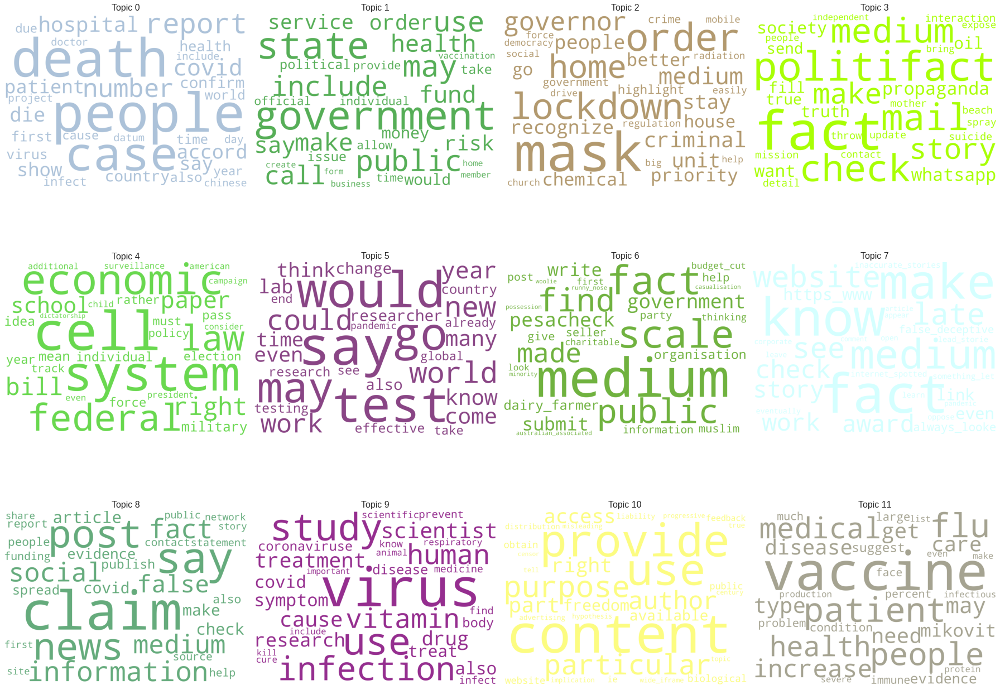

In [27]:
# 1. Wordcloud of Top N words in each topic
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'
cols = [color for name, color in mcolors.XKCD_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'


cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=30,
                  colormap='paired',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = optimal_model.show_topics(formatted=False, num_topics=12, num_words=30)
topics.sort(key=lambda tup: tup[0])

fig, axes = plt.subplots(3, 4, figsize=(25,20), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=550)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
#plt.save('wc.png')
plt.show()

In [30]:
#topic_words = dict(topics[i][1])
from collections import Counter
topics = optimal_model.show_topics(formatted=False, num_topics=19, num_words=30)
topics.sort(key=lambda tup: tup[0])
data_flat = [w for w_list in topic_words for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

'''# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(5, 4, figsize=(16,30), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylabel('Weight', color=cols[i])
    #ax.twin.label('Weight')
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 100)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
    ax.set_facecolor('white')
    ax.grid(False)
    
fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Review Keywords', fontsize=22, y=1.05)    
plt.savefig('plot12.png')
plt.show()'''

'# Plot Word Count and Weights of Topic Keywords\nfig, axes = plt.subplots(5, 4, figsize=(16,30), sharey=True, dpi=160)\ncols = [color for name, color in mcolors.TABLEAU_COLORS.items()]\nfor i, ax in enumerate(axes.flatten()):\n    ax.bar(x=\'word\', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label=\'Word Count\')\n    ax_twin = ax.twinx()\n    ax_twin.bar(x=\'word\', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label=\'Weights\')\n    ax.set_ylabel(\'Word Count\', color=cols[i])\n    ax_twin.set_ylabel(\'Weight\', color=cols[i])\n    #ax.twin.label(\'Weight\')\n    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 100)\n    ax.set_title(\'Topic: \' + str(i), color=cols[i], fontsize=16)\n    ax.tick_params(axis=\'y\', left=False)\n    ax.set_xticklabels(df.loc[df.topic_id==i, \'word\'], rotation=30, horizontalalignment= \'right\')\n    ax.legend(loc=\'upper left\'); ax_twin.legend(loc=\'upper right\')\n    ax.set

In [31]:
topicsdf = pd.DataFrame(topics)

In [32]:
topicsdf

,0,1
0,0,"[(people, 0.035195887), (death, 0.033774994), (case, 0.032120664), (report, 0.025403652), (numbe..."
1,1,"[(trump, 0.0249551), (market, 0.017524835), (power, 0.015613941), (want, 0.015402001), (emergenc..."
2,2,"[(government, 0.022966096), (state, 0.019761845), (may, 0.012186628), (public, 0.011464385), (us..."
3,3,"[(mask, 0.05003819), (order, 0.021845166), (lockdown, 0.019035744), (home, 0.01525451), (governo..."
4,4,"[(fact, 0.026590165), (politifact, 0.022671122), (check, 0.018814709), (mail, 0.018382538), (med..."
5,5,"[(cell, 0.022829322), (system, 0.018992292), (economic, 0.013633974), (federal, 0.013381357), (l..."
6,6,"[(say, 0.016868828), (would, 0.014132224), (test, 0.013993515), (go, 0.012165812), (may, 0.01048..."
7,7,"[(medium, 0.07710273), (fact, 0.03651669), (scale, 0.035665628), (public, 0.026275916), (find, 0..."
8,8,"[(fact, 0.034543917), (know, 0.0324743), (make, 0.030349093), (medium, 0.026929034), (website, 0..."
9,9,"[(claim, 0.046164766), (say, 0.028949631), (post, 0.023055779), (news, 0.021441827), (informatio..."


In [33]:
topicsdf.to_csv('topicsdf.csv')

In [34]:
topics

[(0,
  [('people', 0.035195887),
   ('death', 0.033774994),
   ('case', 0.032120664),
   ('report', 0.025403652),
   ('number', 0.020451456),
   ('covid', 0.016320886),
   ('hospital', 0.01335793),
   ('die', 0.012079608),
   ('accord', 0.011579522),
   ('patient', 0.011156724),
   ('say', 0.011020116),
   ('show', 0.010887645),
   ('country', 0.009947705),
   ('confirm', 0.009937158),
   ('health', 0.008558083),
   ('first', 0.007931903),
   ('virus', 0.007846689),
   ('world', 0.007545961),
   ('also', 0.0075283237),
   ('time', 0.0074010827),
   ('year', 0.0063713263),
   ('due', 0.0063433982),
   ('cause', 0.0061910306),
   ('infect', 0.006154351),
   ('project', 0.0060748174),
   ('day', 0.006058204),
   ('doctor', 0.0056084963),
   ('datum', 0.005585509),
   ('include', 0.0055854376),
   ('chinese', 0.005464697)]),
 (1,
  [('trump', 0.0249551),
   ('market', 0.017524835),
   ('power', 0.015613941),
   ('want', 0.015402001),
   ('emergency', 0.015024309),
   ('people', 0.013065794

#**TSNE Clustering**

In [35]:
%%time
# Get topic weights and dominant topics ------------
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook

# Get topic weights
topic_weights = []
for i, row_list in enumerate(optimal_model[corpus]):
    topic_weights.append([w for i, w in row_list[0]])

# Array of topic weights    
arr = pd.DataFrame(topic_weights).fillna(0).values

# # Keep the well separated points (optional)
# arr = arr[np.amax(arr, axis=1) > 0.35]

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2, verbose=0, random_state=0, angle=.99, init='pca')
tsne_lda = tsne_model.fit_transform(arr)

CPU times: user 1min 24s, sys: 1.78 s, total: 1min 26s
Wall time: 1min 2s


In [36]:
import plotly.express as px
import plotly.graph_objects as go


tsne_lda_df = pd.DataFrame(tsne_lda)
tsne_lda_df.columns = ['col1', 'col2']
tsne_lda_df['topic'] = df_dominant_topic['Dominant_Topic']
raw_data = raw_data.reset_index(drop=True)
#tsne_lda_df['label'] = raw_data['label']
tsne_lda_df['Text'] = raw_data['Text']

tsne_lda_df['topic'] = tsne_lda_df['topic'].astype('object')

plt.set_cmap('tab20')
fig = px.scatter(tsne_lda_df, x='col1', y='col2', hover_name='Text',
              color='topic',
              #facet_col='topic', 
                color_discrete_sequence=px.colors.carto.Bold)
#                   color_discrete_map={"0": "blue", "1": "green", "2":"red", "3":"yellow", "4":"magenta", "5":"cyan",
#                                      "6":"deepskyblue", "7":"lightcoral", "8":"darkorange", "9":"aquamarine",
#                                      "10":"peru", "11":"darkkhaki"})

fig.update_layout(
    title=go.layout.Title(
        text="TSNE representation of fake posts segregated by topics",
        xref="paper",
        x=0
    ),
    xaxis=go.layout.XAxis(
        title=go.layout.xaxis.Title(
            text="TSNE Dim 1",
            font=dict(
                family="Courier New, monospace",
                size=18,
                color="#7f7f7f"
            )
        )
    ),
    yaxis=go.layout.YAxis(
        title=go.layout.yaxis.Title(
            text="TSNE Dim 2",
            font=dict(
                family="Courier New, monospace",
                size=18,
                color="#7f7f7f"
            )
        )
    )
)

fig.show()

<Figure size 576x396 with 0 Axes>

#**Visualizing Topic Model**

In [37]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(optimal_model, corpus, id2word, sort_topics=False)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.205527 -0.076396       1        1  11.471220
1     -0.070299  0.158024       2        1   4.950083
2     -0.111724 -0.012757       3        1  14.710485
3      0.103816  0.144710       4        1   2.622586
4      0.215098 -0.030492       5        1   1.832311
5      0.055322  0.323663       6        1   4.385097
6     -0.195579  0.007858       7        1  13.831856
7      0.234588 -0.065657       8        1   1.191645
8      0.140295 -0.077942       9        1   3.046513
9      0.003989 -0.215123      10        1  13.717793
10    -0.175510 -0.062655      11        1   8.193001
11     0.009841 -0.205003      12        1   9.962469
12     0.163331  0.018439      13        1   2.533776
13    -0.167639  0.093333      14        1   7.551166, topic_info=                         Term          Freq         Total Category  logprob  loglift
32                      virus   9172.000000   9172.000000  Default  30.0000  30.0000
76                     medium   6386.000000   6386.000000  Default  29.0000  29.0000
349                     claim  10851.000000  10851.000000  Default  28.0000  28.0000
252                   vaccine   5115.000000   5115.000000  Default  27.0000  27.0000
270                      fact   6658.000000   6658.000000  Default  26.0000  26.0000
475                     video   4883.000000   4883.000000  Default  25.0000  25.0000
203                       use   7485.000000   7485.000000  Default  24.0000  24.0000
419                     death   4656.000000   4656.000000  Default  23.0000  23.0000
476                     viral   4192.000000   4192.000000  Default  22.0000  22.0000
3                        case   4572.000000   4572.000000  Default  21.0000  21.0000
458                      find   5181.000000   5181.000000  Default  20.0000  20.0000
90                     public   4035.000000   4035.000000  Default  19.0000  19.0000
59                 government   4728.000000   4728.000000  Default  18.0000  18.0000
73                       make   6711.000000   6711.000000  Default  17.0000  17.0000
88                       post   5577.000000   5577.000000  Default  16.0000  16.0000
84                     people   9876.000000   9876.000000  Default  15.0000  15.0000
136               information   3616.000000   3616.000000  Default  14.0000  14.0000
347                     check   4106.000000   4106.000000  Default  13.0000  13.0000
400                      know   4119.000000   4119.000000  Default  12.0000  12.0000
23                     report   6067.000000   6067.000000  Default  11.0000  11.0000
193                   provide   2353.000000   2353.000000  Default  10.0000  10.0000
411                     study   2794.000000   2794.000000  Default   9.0000   9.0000
1724                  content   1745.000000   1745.000000  Default   8.0000   8.0000
1730                  message   2926.000000   2926.000000  Default   7.0000   7.0000
195                       say  10816.000000  10816.000000  Default   6.0000   6.0000
364                      news   4661.000000   4661.000000  Default   5.0000   5.0000
507                      mask   1577.000000   1577.000000  Default   4.0000   4.0000
549                 infection   2805.000000   2805.000000  Default   3.0000   3.0000
95                        see   4488.000000   4488.000000  Default   2.0000   2.0000
369                    social   3580.000000   3580.000000  Default   1.0000   1.0000
419                     death   4655.592154   4656.046571   Topic1  -3.3880   2.1652
1406                 estimate    722.188665    722.643082   Topic1  -5.2516   2.1647
344                 worldwide    533.656442    534.110861   Topic1  -5.5541   2.1645
2058                      lie    526.016024    526.470442   Topic1  -5.5685   2.1645
2125                      job    525.463466    525.917886   Topic1  -5.5696   2.1645
2073                    store    

In [38]:
p = pyLDAvis.gensim.prepare(optimal_model, corpus, id2word, sort_topics=False)
pyLDAvis.save_html(p, 'finallda2.html')

#**Try**

IndexError: ignored

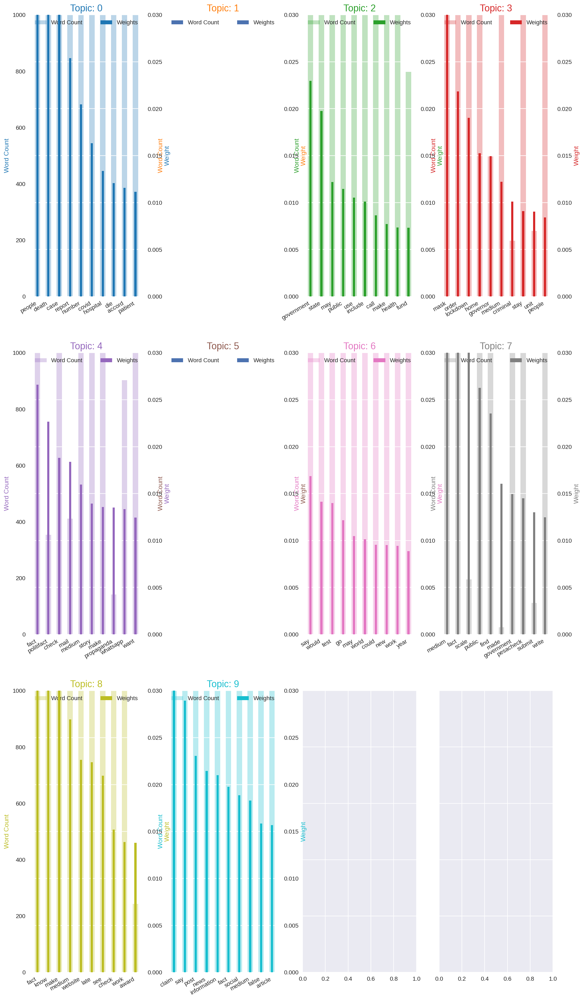

In [39]:
from collections import Counter
topics = optimal_model.show_topics(formatted=False)
data_flat = [w for w_list in texts for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(3, 4, figsize=(16,30), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylabel('Weight', color=cols[i])
    #ax.twin.label('Weight')
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 1000)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
    ax.set_facecolor('white')
    ax.grid(False)
    
fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Review Keywords', fontsize=22, y=1.05)    
plt.savefig('plot12.png')
plt.show()

In [40]:
# Sentence Coloring of N Sentences
def topics_per_document(model, corpus, start=0, end=1):
    corpus_sel = corpus[start:end]
    dominant_topics = []
    topic_percentages = []
    for i, corp in enumerate(corpus_sel):
        topic_percs, wordid_topics, wordid_phivalues = model[corp]
        dominant_topic = sorted(topic_percs, key = lambda x: x[1], reverse=True)[0][0]
        dominant_topics.append((i, dominant_topic))
        topic_percentages.append(topic_percs)
    return(dominant_topics, topic_percentages)

dominant_topics, topic_percentages = topics_per_document(model=optimal_model, corpus=corpus, end=-1)            

# Distribution of Dominant Topics in Each Document
df = pd.DataFrame(dominant_topics, columns=['Document_Id', 'Dominant_Topic'])
dominant_topic_in_each_doc = df.groupby('Dominant_Topic').size()
df_dominant_topic_in_each_doc = dominant_topic_in_each_doc.to_frame(name='count').reset_index()

# Total Topic Distribution by actual weight
topic_weightage_by_doc = pd.DataFrame([dict(t) for t in topic_percentages])
df_topic_weightage_by_doc = topic_weightage_by_doc.sum().to_frame(name='count').reset_index()

# Top 3 Keywords for each Topic
topic_top3words = [(i, topic) for i, topics in optimal_model.show_topics(formatted=False) 
                                 for j, (topic, wt) in enumerate(topics) if j < 3]

df_top3words_stacked = pd.DataFrame(topic_top3words, columns=['topic_id', 'words'])
df_top3words = df_top3words_stacked.groupby('topic_id').agg(', \n'.join)
df_top3words.reset_index(level=0,inplace=True)

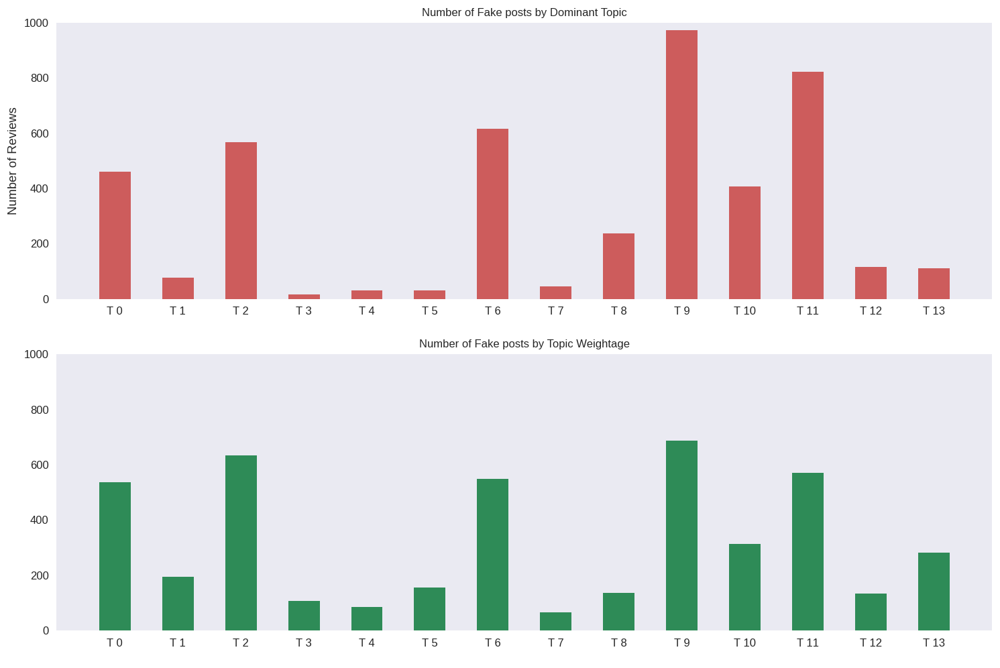

In [43]:
from matplotlib.ticker import FuncFormatter

# Plot
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 10), dpi=120, sharey=True)

# Topic Distribution by Dominant Topics
ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc, width=.5, color='indianred')
ax1.set_xticks(range(df_dominant_topic_in_each_doc.Dominant_Topic.unique().__len__()))
tick_formatter = FuncFormatter(lambda x, pos: 'T ' + str(x)+ '\n')
ax1.xaxis.set_major_formatter(tick_formatter)
ax1.set_title('Number of Fake posts by Dominant Topic', fontdict=dict(size=10))
ax1.set_ylabel('Number of Reviews')
ax1.set_ylim(0, 1000)
ax1.grid(False)
# Topic Distribution by Topic Weights
ax2.bar(x='index', height='count', data=df_topic_weightage_by_doc, width=.5, color='seagreen')
ax2.set_xticks(range(df_topic_weightage_by_doc.index.unique().__len__()))
ax2.xaxis.set_major_formatter(tick_formatter)
ax2.set_title('Number of Fake posts by Topic Weightage', fontdict=dict(size=10))
#ax2.set_ylim(0, 1000)
ax2.grid(False)
plt.savefig('pic4.png')
plt.show()

In [ ]:
#dividing datasets according to topic subsets
topic0 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 0.0]
topic1 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 1.0]
topic2 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 2.0]
topic3 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 3.0]
topic4 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 4.0]
topic5 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 5.0]
topic6 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 6.0]
topic7 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 7.0]
topic8 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 8.0]
topic9 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 9.0]
topic10 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 10.0]
topic11 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 11.0]
topic12 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 12.0]
topic13 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 13.0]
topic14 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 14.0]
topic15 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 15.0]
topic16 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 16.0]
topic17 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 17.0]
topic18 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 18.0]
topic19 = df_dominant_topic[df_dominant_topic['Dominant_Topic'] == 19.0]